Import statements

In [1]:
#Importing all the neccessary libraries
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB,BernoulliNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix

!pip install kaggle
from google.colab import files
files.upload()

!kaggle datasets download -d prosperchuks/health-dataset -f diabetes_data.csv

!pip install fairlearn
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix,ConfusionMatrixDisplay
from fairlearn.metrics import MetricFrame
import fairlearn.datasets as fdata
from fairlearn.metrics import (demographic_parity_difference, demographic_parity_ratio, 
                               selection_rate_difference, false_negative_rate_difference, 
                               false_positive_rate_difference, equalized_odds_ratio,
                               false_negative_rate, false_positive_rate)
from sklearn.metrics import accuracy_score, precision_score, recall_score

!pip install lime
import lime
import lime.lime_tabular
from lime import submodular_pick

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Saving diabetes_data.csv to diabetes_data.csv
Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.10/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.10/dist-packages/kaggle/api/kaggle_api_extended.py", line 164, in authenticate
    raise IOError('Could not find {}. Make sure it\'s located in'
OSError: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.0/235.0 kB 9.6 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=l

Importing data

In [2]:
df = pd.read_csv('diabetes_data.csv')
pd.set_option('display.max_columns',30)
df.head()

,Age,Sex,HighChol,CholCheck,BMI,Smoker,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,GenHlth,MentHlth,PhysHlth,DiffWalk,Stroke,HighBP,Diabetes
0,4.0,1.0,0.0,1.0,26.0,0.0,0.0,1.0,0.0,1.0,0.0,3.0,5.0,30.0,0.0,0.0,1.0,0.0
1,12.0,1.0,1.0,1.0,26.0,1.0,0.0,0.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,1.0,1.0,0.0
2,13.0,1.0,0.0,1.0,26.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,10.0,0.0,0.0,0.0,0.0
3,11.0,1.0,1.0,1.0,28.0,1.0,0.0,1.0,1.0,1.0,0.0,3.0,0.0,3.0,0.0,0.0,1.0,0.0
4,8.0,0.0,0.0,1.0,29.0,1.0,0.0,1.0,1.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0


# Data Cleaning and Processing from ADS

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70692 entries, 0 to 70691
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Age                   70692 non-null  float64
 1   Sex                   70692 non-null  float64
 2   HighChol              70692 non-null  float64
 3   CholCheck             70692 non-null  float64
 4   BMI                   70692 non-null  float64
 5   Smoker                70692 non-null  float64
 6   HeartDiseaseorAttack  70692 non-null  float64
 7   PhysActivity          70692 non-null  float64
 8   Fruits                70692 non-null  float64
 9   Veggies               70692 non-null  float64
 10  HvyAlcoholConsump     70692 non-null  float64
 11  GenHlth               70692 non-null  float64
 12  MentHlth              70692 non-null  float64
 13  PhysHlth              70692 non-null  float64
 14  DiffWalk              70692 non-null  float64
 15  Stroke             

In [4]:
#Assessing for missing values
df.isnull().sum()

Age                     0
Sex                     0
HighChol                0
CholCheck               0
BMI                     0
Smoker                  0
HeartDiseaseorAttack    0
PhysActivity            0
Fruits                  0
Veggies                 0
HvyAlcoholConsump       0
GenHlth                 0
MentHlth                0
PhysHlth                0
DiffWalk                0
Stroke                  0
HighBP                  0
Diabetes                0
dtype: int64

In [5]:
#Evaluating number of unique values in each column
unique_vals=[]

for col in df.columns:
    unival=df[col].nunique()
    unique_vals.append(unival)

#Presenting the findings using a dataframe
pd.DataFrame(unique_vals,columns=['Unique_Values'],index=df.columns)

,Unique_Values
Age,13
Sex,2
HighChol,2
CholCheck,2
BMI,80
Smoker,2
HeartDiseaseorAttack,2
PhysActivity,2
Fruits,2
Veggies,2


In [ ]:
df.columns

Index(['Age', 'Sex', 'HighChol', 'CholCheck', 'BMI', 'Smoker',
       'HeartDiseaseorAttack', 'PhysActivity', 'Fruits', 'Veggies',
       'HvyAlcoholConsump', 'GenHlth', 'MentHlth', 'PhysHlth', 'DiffWalk',
       'Stroke', 'HighBP', 'Diabetes'],
      dtype='object')

In [10]:
cols=['Age', 'Sex', 'HighChol', 'CholCheck', 'Smoker',
       'HeartDiseaseorAttack', 'PhysActivity', 'Fruits', 'Veggies',
       'HvyAlcoholConsump', 'GenHlth', 'DiffWalk',
       'Diabetes', 'Stroke']

************************************************************************************************


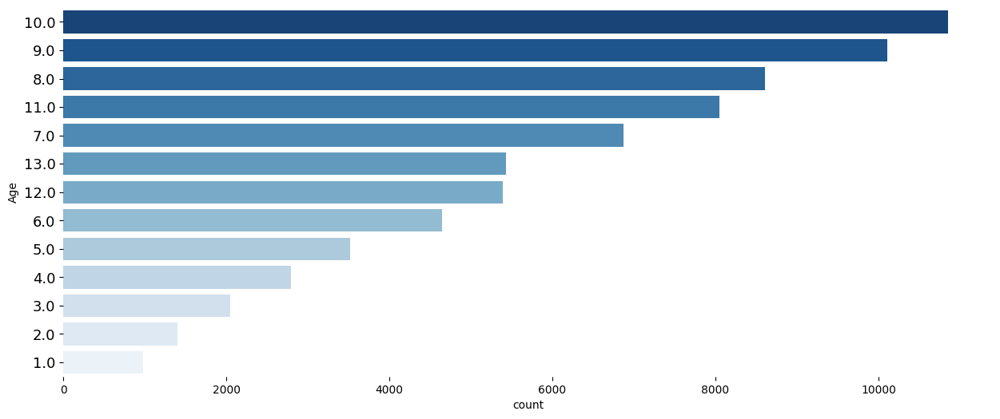

************************************************************************************************


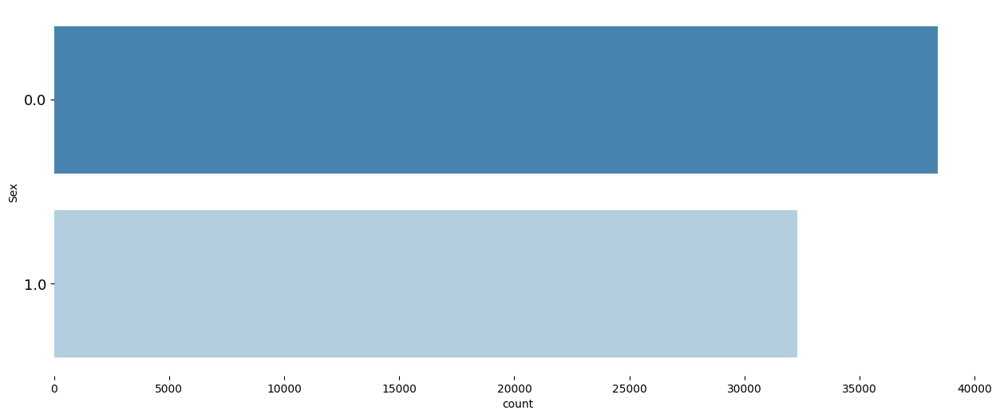

************************************************************************************************


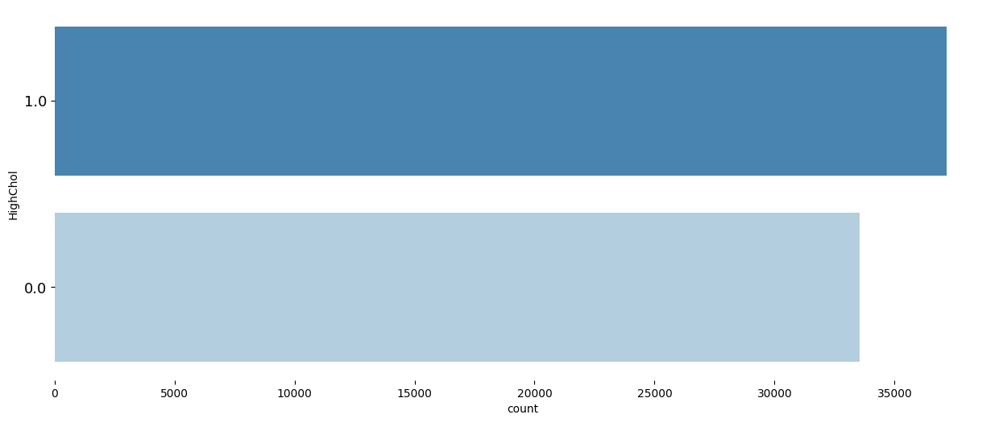

************************************************************************************************


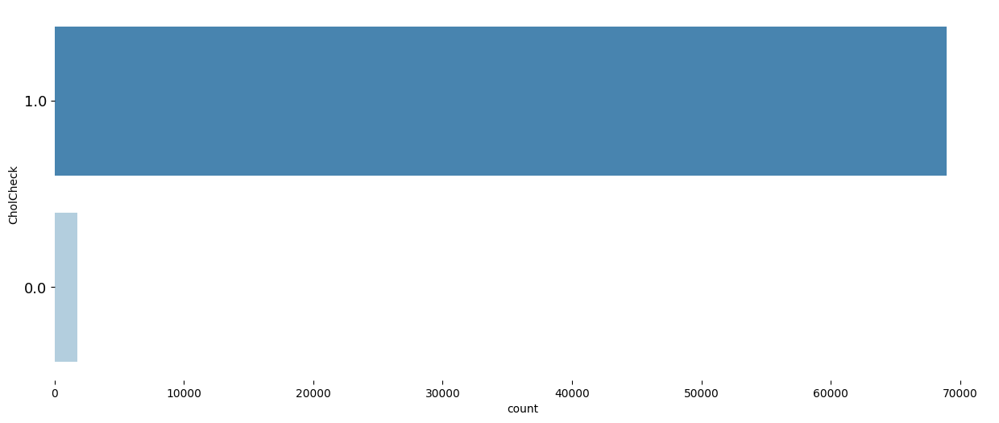

************************************************************************************************


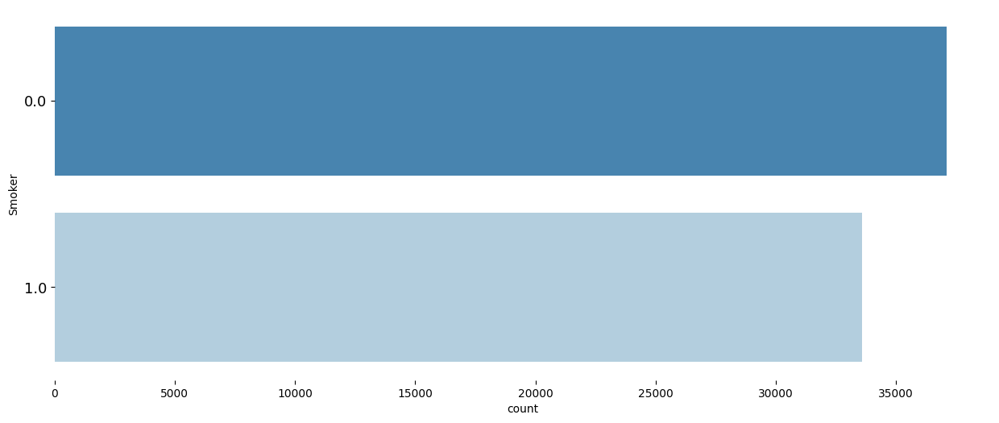

************************************************************************************************


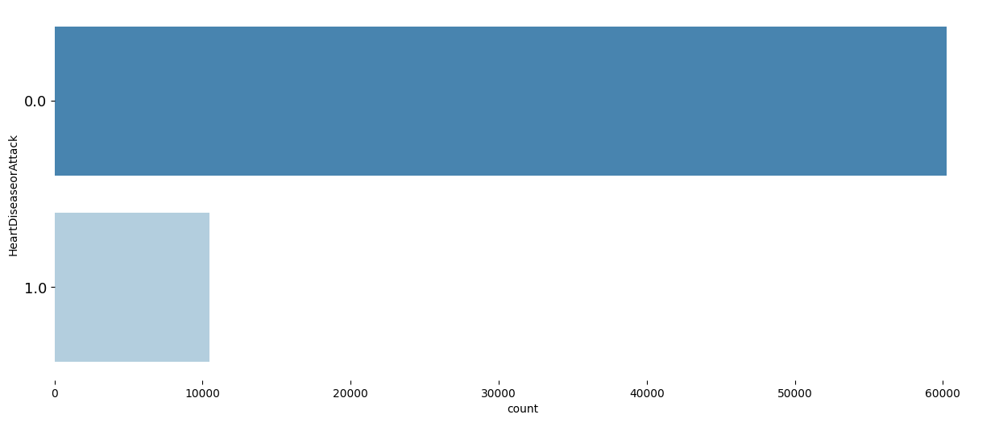

************************************************************************************************


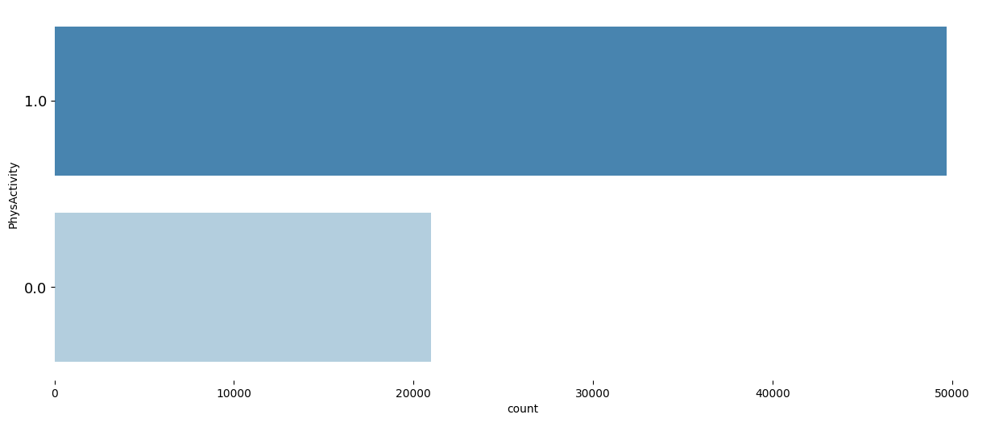

************************************************************************************************


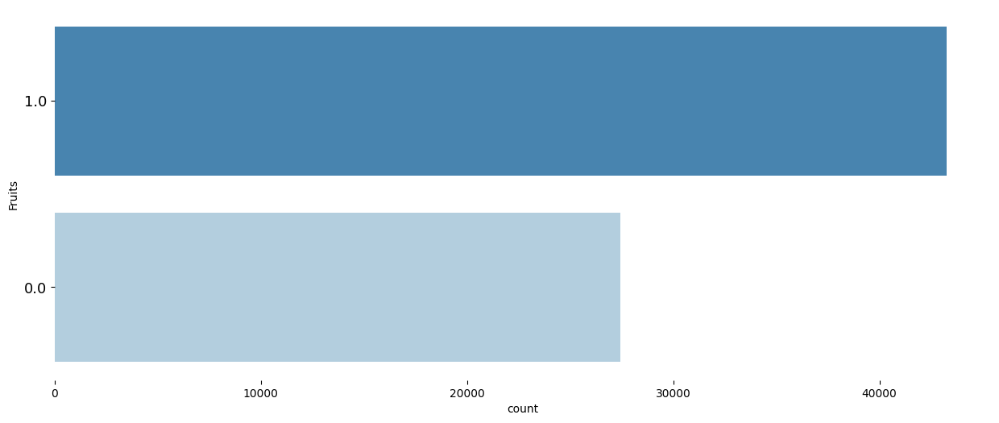

************************************************************************************************


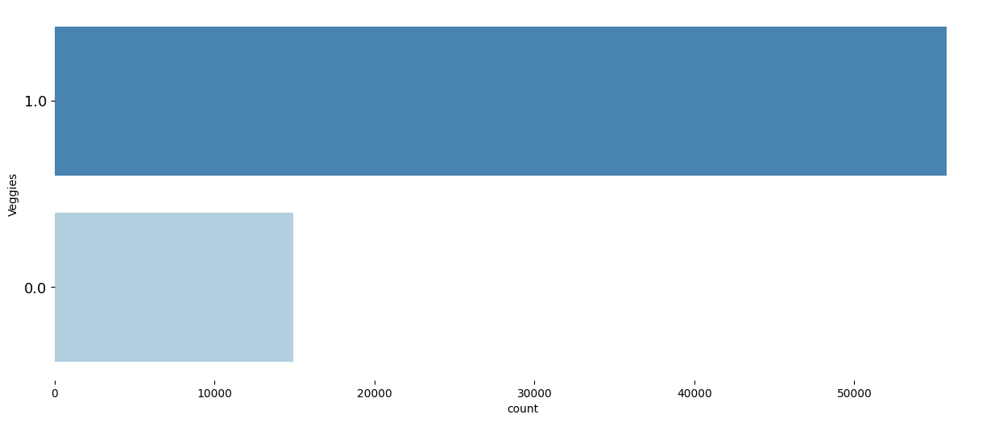

************************************************************************************************


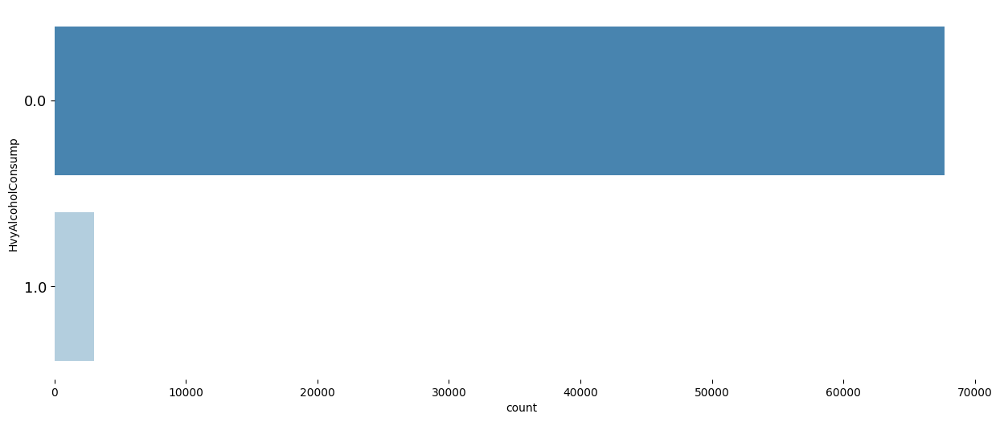

************************************************************************************************


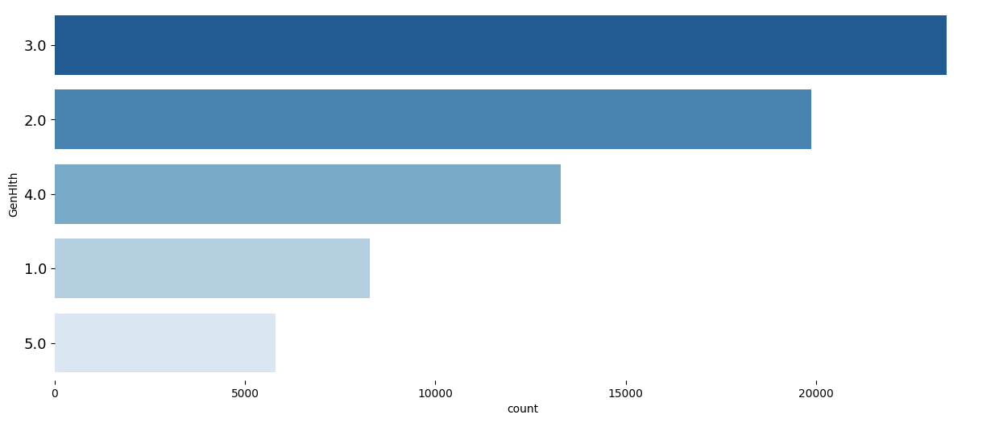

************************************************************************************************


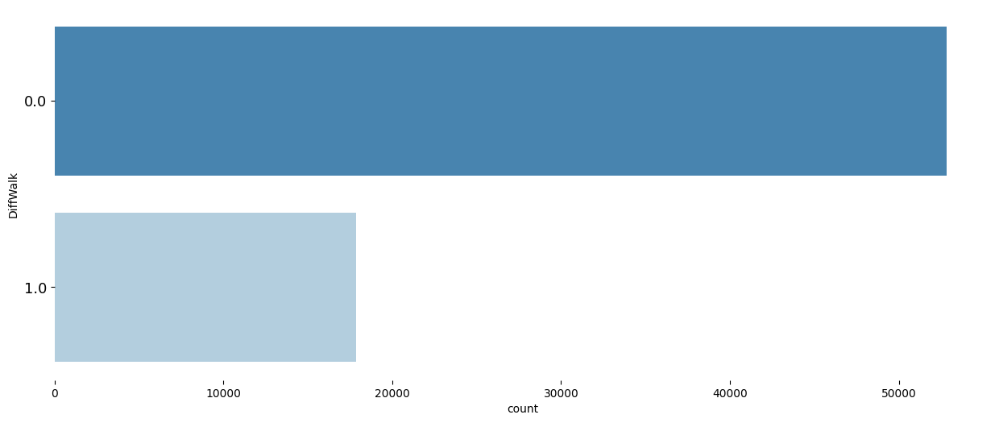

************************************************************************************************


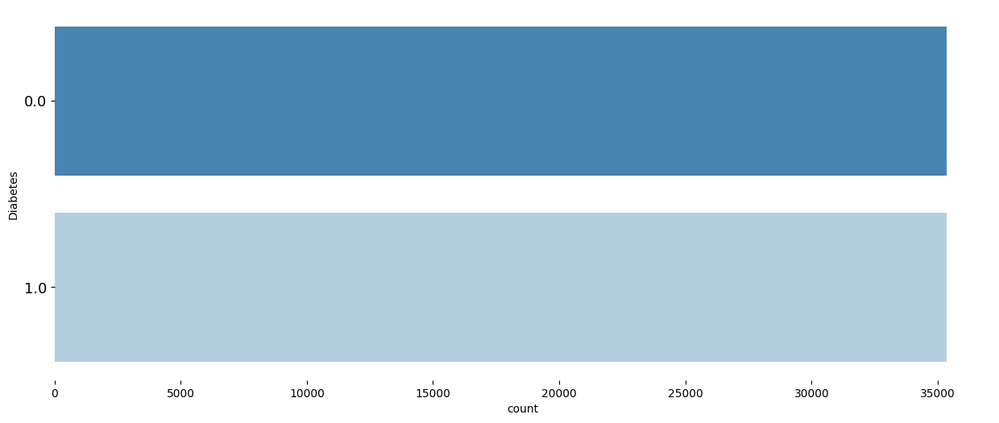

************************************************************************************************


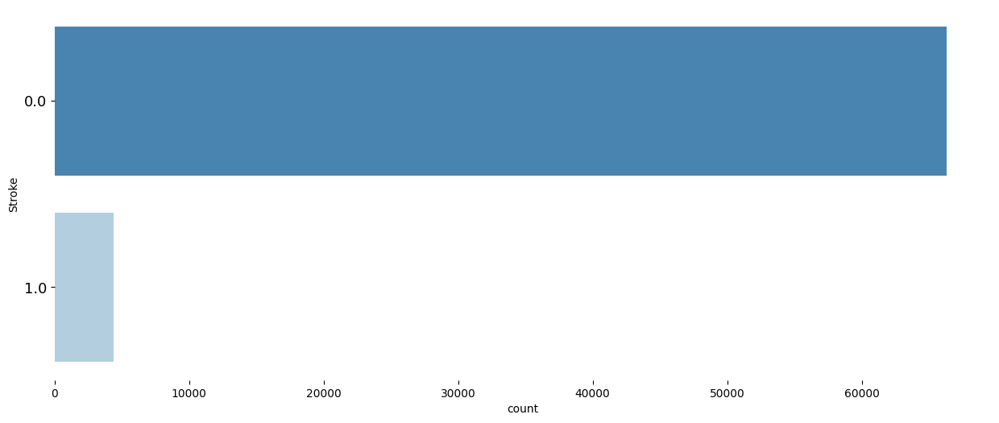

In [11]:
#Presenting the countplots for categorical features
for i in cols:
  fig, ax = plt.subplots(1,1, figsize=(15, 6))
  sns.countplot(y = df[i],data=df, order=df[i].value_counts().index, palette='Blues_r')
  plt.ylabel(i)
  plt.yticks(fontsize=13)
  print("************************************************************************************************")
  plt.box(False)
  plt.show()

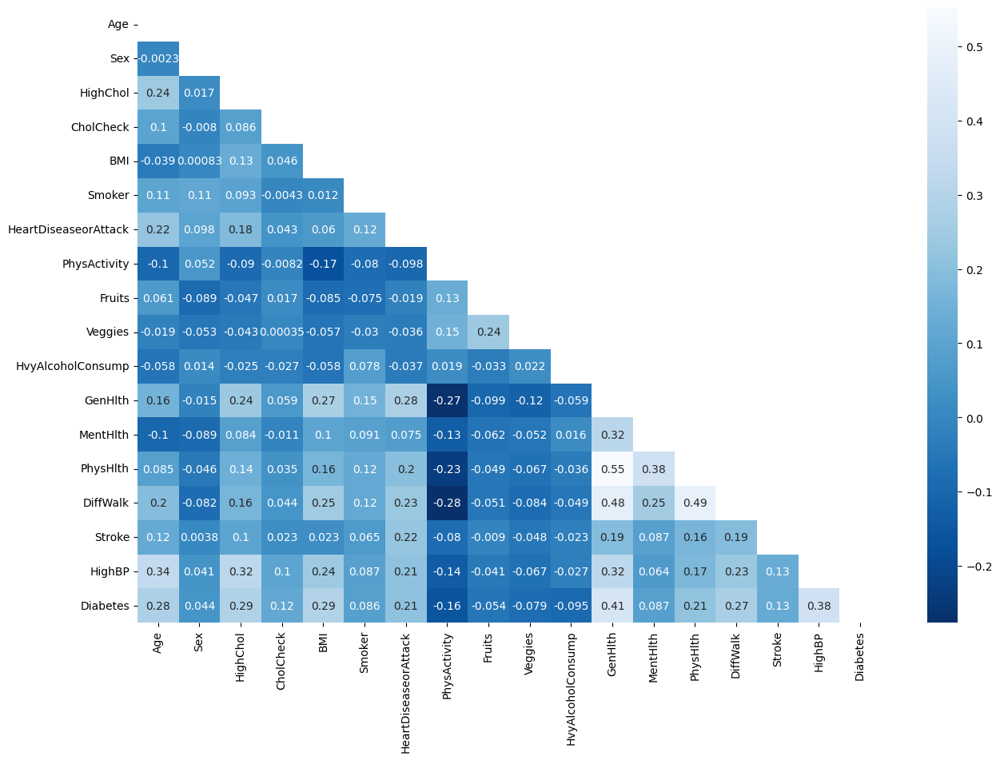

In [12]:
plt.figure(figsize=(15,10))
mask=np.triu(df.corr())
sns.heatmap(df.corr(),mask=mask,annot=True,cmap='Blues_r')
plt.show()

In [13]:
#one-hot encoding
df['BMI'] = np.where(df['BMI']>29, 1.0, 0.0)

In [14]:
#split data into target and features
X=df.drop('Stroke',axis=1)
y=df['Stroke']
y

0        0.0
1        1.0
2        0.0
3        0.0
4        0.0
        ... 
70687    0.0
70688    0.0
70689    0.0
70690    0.0
70691    0.0
Name: Stroke, Length: 70692, dtype: float64

In [15]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=105,stratify=y)

In [16]:
#scaling the data so that comparatively larger values do not make the model biased
scaler=StandardScaler()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.transform(X_test)

In [17]:
Xtraindf = pd.DataFrame(X_train_scaled, columns = X_train.columns)
Xtraindf.head()

,Age,Sex,HighChol,CholCheck,BMI,Smoker,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,GenHlth,MentHlth,PhysHlth,DiffWalk,HighBP,Diabetes
0,-1.969393,1.086989,-1.055238,0.159256,-0.897620,1.048121,-0.417097,0.650618,0.796748,0.515403,-0.211825,-0.755094,-0.459880,-0.577695,-0.583542,-1.138573,-1.006976
1,0.844903,1.086989,-1.055238,0.159256,1.114057,-0.954088,-0.417097,0.650618,0.796748,0.515403,-0.211825,-0.755094,-0.459880,-0.577695,-0.583542,-1.138573,0.993072
2,-1.265819,-0.919972,-1.055238,0.159256,1.114057,-0.954088,-0.417097,0.650618,-1.255101,-1.940230,-0.211825,1.937626,-0.459880,2.401520,1.713673,-1.138573,0.993072
3,-0.562245,-0.919972,-1.055238,0.159256,1.114057,-0.954088,-0.417097,0.650618,-1.255101,0.515403,-0.211825,1.040053,1.995978,0.415377,-0.583542,-1.138573,0.993072
4,1.548477,-0.919972,-1.055238,0.159256,-0.897620,1.048121,-0.417097,0.650618,0.796748,0.515403,-0.211825,0.142479,-0.459880,-0.577695,-0.583542,0.878293,0.993072


# Generic Functions for Fairness Metrics

In [18]:
accuracy_model=pd.DataFrame(columns=['Model','Accuracy'])

In [19]:
#function to create metric frame with the necessary metrics for our analysis
def create_metrics(sensitive_features):
  metric_dict_full = {'accuracy': accuracy_score,
            'recall': recall_score,
            'precision': precision_score,
            'fnr': false_negative_rate,
            'fpr': false_positive_rate,
            'false_negative_rate_difference': false_negative_rate_difference,
            'false_positive_rate_difference': false_positive_rate_difference,
            'demographic_parity_ratio': demographic_parity_ratio,
            'equalized_odds_ratio': equalized_odds_ratio,
            'selection_rate_difference': selection_rate_difference
            }
  sample_params = {
        'false_negative_rate_difference': {'sensitive_features':sensitive_features},
        'false_positive_rate_difference': {'sensitive_features': sensitive_features},
        'demographic_parity_ratio': {'sensitive_features': sensitive_features},
        'equalized_odds_ratio': {'sensitive_features': sensitive_features},
        'selection_rate_difference': {'sensitive_features': sensitive_features}
    }
  return metric_dict_full, sample_params

In [20]:
#Function to print metric frame and how they relate to each group
def print_metrics(mf, sensitive_features, pred, sp):
  metrics = MetricFrame(
      metrics=mf,
      y_true=y_test,
      y_pred=pred,
      sensitive_features=sensitive_features,
      sample_params = sp
  )
  print(metrics.overall)
  print(metrics.by_group[['accuracy', 'recall', 'precision', 'fnr', 'fpr']])

# Testing Models

**Logistic Regression**

In [21]:
grid={"C":np.logspace(-3,3,7), "penalty":["l1","l2"]}
logreg=LogisticRegression()
logreg_cv=GridSearchCV(logreg,grid,cv=10)
logreg.fit(X_train_scaled,y_train)
ypred=logreg.predict(X_test_scaled)

In [22]:
# Testing Sex
mf, sp = create_metrics(X_test['Sex'])
print_metrics(mf, X_test['Sex'], ypred, sp)

accuracy                          0.937194
recall                            0.001516
precision                         0.117647
fnr                               0.998484
fpr                               0.000754
false_negative_rate_difference    0.000154
false_positive_rate_difference    0.000044
demographic_parity_ratio          0.934473
equalized_odds_ratio              0.903319
selection_rate_difference         0.000054
dtype: float64
     accuracy    recall  precision       fnr       fpr
Sex                                                   
0.0  0.939577  0.001443   0.111111  0.998557  0.000734
1.0  0.934324  0.001597   0.125000  0.998403  0.000778


In [23]:
# Testing BMI
mf, sp = create_metrics(X_test['BMI'])
print_metrics(mf, X_test['BMI'], ypred, sp)

accuracy                          0.937194
recall                            0.001516
precision                         0.117647
fnr                               0.998484
fpr                               0.000754
false_negative_rate_difference    0.000131
false_positive_rate_difference    0.001345
demographic_parity_ratio          0.079053
equalized_odds_ratio              0.000000
selection_rate_difference         0.001244
dtype: float64
     accuracy    recall  precision       fnr       fpr
BMI                                                   
0.0  0.940729  0.001453     0.0625  0.998547  0.001345
1.0  0.932721  0.001585     1.0000  0.998415  0.000000


**Gaussian Naive Model**

In [24]:
#Fit Model
gnb=GaussianNB()
gnb.fit(X_train_scaled,y_train)
y_pred1=gnb.predict(X_test_scaled)

In [25]:
# Testing Sex
mf, sp = create_metrics(X_test['Sex'])
print_metrics(mf, X_test['Sex'], y_pred1, sp)

accuracy                          0.821671
recall                            0.540561
precision                         0.183338
fnr                               0.459439
fpr                               0.159686
false_negative_rate_difference    0.001851
false_positive_rate_difference    0.008260
demographic_parity_ratio          0.969704
equalized_odds_ratio              0.949457
selection_rate_difference         0.005633
dtype: float64
     accuracy    recall  precision       fnr       fpr
Sex                                                   
0.0  0.818817  0.539683   0.173630  0.460317  0.163423
1.0  0.825107  0.541534   0.195389  0.458466  0.155163


In [26]:
# Testing BMI
mf, sp = create_metrics(X_test['BMI'])
print_metrics(mf, X_test['BMI'], y_pred1, sp)

accuracy                          0.821671
recall                            0.540561
precision                         0.183338
fnr                               0.459439
fpr                               0.159686
false_negative_rate_difference    0.145552
false_positive_rate_difference    0.123194
demographic_parity_ratio          0.497486
equalized_odds_ratio              0.461535
selection_rate_difference         0.128097
dtype: float64
     accuracy    recall  precision       fnr       fpr
BMI                                                   
0.0  0.869807  0.470930   0.215712  0.529070  0.105593
1.0  0.760786  0.616482   0.162966  0.383518  0.228787


**Bernoulli Naive Bayes**

In [27]:
bnb=BernoulliNB()
bnb.fit(X_train_scaled,y_train)
y_pred2=bnb.predict(X_test_scaled)

In [28]:
# Testing Sex
mf, sp = create_metrics(X_test['Sex'])
print_metrics(mf, X_test['Sex'], y_pred2, sp)

accuracy                          0.880234
recall                            0.372252
precision                         0.222878
fnr                               0.627748
fpr                               0.086078
false_negative_rate_difference    0.009211
false_positive_rate_difference    0.004961
demographic_parity_ratio          0.964684
equalized_odds_ratio              0.943835
selection_rate_difference         0.003728
dtype: float64
     accuracy    recall  precision       fnr       fpr
Sex                                                   
0.0  0.879672  0.376623   0.213410  0.623377  0.088322
1.0  0.880910  0.367412   0.234694  0.632588  0.083361


In [29]:
# BMI
mf, sp = create_metrics(X_test['BMI'])
print_metrics(mf, X_test['BMI'], y_pred2, sp)

accuracy                          0.880234
recall                            0.372252
precision                         0.222878
fnr                               0.627748
fpr                               0.086078
false_negative_rate_difference    0.143131
false_positive_rate_difference    0.080491
demographic_parity_ratio          0.429078
equalized_odds_ratio              0.386622
selection_rate_difference         0.087065
dtype: float64
     accuracy    recall  precision       fnr       fpr
BMI                                                   
0.0  0.911770  0.303779   0.269677  0.696221  0.050735
1.0  0.840346  0.446910   0.197479  0.553090  0.131226


**k-Nearest Neighbors**

In [34]:
knn = KNeighborsClassifier()

k_range = list(range(1, 20))
param_grid = dict(n_neighbors=k_range)
  
grid = GridSearchCV(knn, param_grid, cv=10, scoring='accuracy', return_train_score=False,verbose=1)
grid_search=grid.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 19 candidates, totalling 190 fits


In [35]:
print(grid_search.best_params_)
accuracy = grid_search.best_score_ *100
print("Accuracy for our training dataset with tuning is : {:.2f}%".format(accuracy) )

{'n_neighbors': 18}
Accuracy for our training dataset with tuning is : 93.72%


In [36]:
knn1 = KNeighborsClassifier(n_neighbors=18)
knn1.fit(X_train_scaled,y_train)
y_pred3=knn1.predict(X_test_scaled)

In [37]:
# Testing Sex
mf, sp = create_metrics(X_test['Sex'])
print_metrics(mf, X_test['Sex'], y_pred3, sp)

accuracy                          0.937146
recall                            0.003791
precision                         0.208333
fnr                               0.996209
fpr                               0.000955
false_negative_rate_difference    0.001134
false_positive_rate_difference    0.000527
demographic_parity_ratio          0.601943
equalized_odds_ratio              0.558750
selection_rate_difference         0.000550
dtype: float64
     accuracy    recall  precision       fnr       fpr
Sex                                                   
0.0  0.939318  0.004329     0.1875  0.995671  0.001194
1.0  0.934532  0.003195     0.2500  0.996805  0.000667


In [38]:
# Testing BMI
mf, sp = create_metrics(X_test['BMI'])
print_metrics(mf, X_test['BMI'], y_pred3, sp)

accuracy                          0.937146
recall                            0.003791
precision                         0.208333
fnr                               0.996209
fpr                               0.000955
false_negative_rate_difference    0.001191
false_positive_rate_difference    0.000478
demographic_parity_ratio          0.632422
equalized_odds_ratio              0.589594
selection_rate_difference         0.000497
dtype: float64
     accuracy   recall  precision      fnr       fpr
BMI                                                 
0.0  0.941067  0.00436     0.1875  0.99564  0.001165
1.0  0.932187  0.00317     0.2500  0.99683  0.000687


**Decision Tree**

In [39]:
param_grid = {'max_features': ['sqrt', 'log2'],
              'ccp_alpha': [0.1, .01, .001],
              'max_depth' : [5, 6, 7, 8, 9],
              'criterion' :['gini', 'entropy']
             }
tree_clas = DecisionTreeClassifier()
grid_search = GridSearchCV(estimator=tree_clas, param_grid=param_grid, cv=5, verbose=True)
grid_search.fit(X_train_scaled, y_train)

Fitting 5 folds for each of 60 candidates, totalling 300 fits


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'ccp_alpha': [0.1, 0.01, 0.001],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 6, 7, 8, 9],
                         'max_features': ['sqrt', 'log2']},
             verbose=True)

In [40]:
print(grid_search.best_params_)
accuracy = grid_search.best_score_ *100
print("Accuracy for our training dataset with tuning is : {:.2f}%".format(accuracy) )

{'ccp_alpha': 0.1, 'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt'}
Accuracy for our training dataset with tuning is : 93.78%


In [41]:
dt = DecisionTreeClassifier(ccp_alpha=0.1,criterion='gini',max_depth=5)
dt.fit(X_train_scaled,y_train)
y_pred4=dt.predict(X_test_scaled)

In [42]:
# Testing Sex
mf, sp = create_metrics(X_test['Sex'])
print_metrics(mf, X_test['Sex'], y_pred4, sp)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


accuracy                          0.937806
recall                            0.000000
precision                         0.000000
fnr                               1.000000
fpr                               0.000000
false_negative_rate_difference    0.000000
false_positive_rate_difference    0.000000
demographic_parity_ratio               NaN
equalized_odds_ratio                   NaN
selection_rate_difference         0.000000
dtype: float64
     accuracy  recall  precision  fnr  fpr
Sex                                       
0.0  0.940181     0.0        0.0  1.0  0.0
1.0  0.934948     0.0        0.0  1.0  0.0


In [43]:
# Testing BMI
mf, sp = create_metrics(X_test['BMI'])
print_metrics(mf, X_test['BMI'], y_pred4, sp)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


accuracy                          0.937806
recall                            0.000000
precision                         0.000000
fnr                               1.000000
fpr                               0.000000
false_negative_rate_difference    0.000000
false_positive_rate_difference    0.000000
demographic_parity_ratio               NaN
equalized_odds_ratio                   NaN
selection_rate_difference         0.000000
dtype: float64
     accuracy  recall  precision  fnr  fpr
BMI                                       
0.0  0.941912     0.0        0.0  1.0  0.0
1.0  0.932614     0.0        0.0  1.0  0.0


# Using Lime

We're using LIME here to find the most important features to see how robust the ADS is

**Gaussian Naive Bayes**

In [48]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['Stroke'], verbose=True, mode='regression')

idxs = np.random.choice(50, size=5, replace=False, p=None)


for i in idxs:
  exp = explainer.explain_instance(X_test_scaled[i], gnb.predict, num_features=17)
  exp.show_in_notebook(show_table=True)

Intercept 0.39285051466204274
Prediction_local [0.60874109]
Right: 1.0


Intercept 0.9581931169292447
Prediction_local [0.03508869]
Right: 0.0


Intercept 0.9975035845052188
Prediction_local [0.02888178]
Right: 0.0


Intercept 0.586958081649211
Prediction_local [0.08426362]
Right: 0.0


Intercept 0.42590370831416785
Prediction_local [0.23294674]
Right: 0.0


**Bernoulli Naive Bayes**

In [49]:
for i in idxs:
  exp = explainer.explain_instance(X_test_scaled[i], bnb.predict, num_features=17)
  exp.show_in_notebook(show_table=True)

Intercept -0.017500797718099592
Prediction_local [0.64464828]
Right: 1.0


Intercept 0.2809573864910067
Prediction_local [-0.01512645]
Right: 0.0


Intercept 0.2560964057259917
Prediction_local [-0.01467333]
Right: 0.0


Intercept 0.2689805806976812
Prediction_local [-0.03186871]
Right: 0.0


Intercept 0.2858700303154289
Prediction_local [-0.01833071]
Right: 0.0


**Logistic Regression**

In [50]:
for i in idxs:
  exp = explainer.explain_instance(X_test_scaled[i], logreg.predict, num_features=17)
  exp.show_in_notebook(show_table=True)

Intercept 0.9595041870821583
Prediction_local [0.25462213]
Right: 0.0


Intercept 1.1927485804635574
Prediction_local [0.13208821]
Right: 0.0


Intercept 1.1992151350208369
Prediction_local [0.132719]
Right: 0.0


Intercept 1.1700380078325496
Prediction_local [0.1712853]
Right: 0.0


Intercept 1.15454521160844
Prediction_local [0.17178576]
Right: 0.0


**kNN Nearest Neighbors**

In [51]:
for i in idxs:
  exp = explainer.explain_instance(X_test_scaled[i], knn1.predict, num_features=17)
  exp.show_in_notebook(show_table=True)

Intercept -0.00027832040756301955
Prediction_local [0.00125679]
Right: 0.0


Intercept 0.005025902653107191
Prediction_local [-0.00065334]
Right: 0.0


Intercept 0.0054378060782862125
Prediction_local [-0.00081493]
Right: 0.0


Intercept 0.0006681614156614798
Prediction_local [0.00020501]
Right: 0.0


Intercept 0.0
Prediction_local [0.]
Right: 0.0


Decision Tree

In [52]:
for i in idxs:
  exp = explainer.explain_instance(X_test_scaled[i], dt.predict, num_features=17)
  exp.show_in_notebook(show_table=True)

Intercept 0.0
Prediction_local [0.]
Right: 0.0


Intercept 0.0
Prediction_local [0.]
Right: 0.0


Intercept 0.0
Prediction_local [0.]
Right: 0.0


Intercept 0.0
Prediction_local [0.]
Right: 0.0


Intercept 0.0
Prediction_local [0.]
Right: 0.0
